# Imports

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from matplotlib import animation
from IPython import display

import torch
import torch.nn as nn
import torch.optim as optim
from torch import Tensor
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader

!pip install /kaggle/input/torchsummary/torchsummary-1.5.1-py3-none-any.whl
from torchsummary import summary

Processing /kaggle/input/torchsummary/torchsummary-1.5.1-py3-none-any.whl


# Preprocessing Utilites

In [3]:
data_dir: str = '/kaggle/input/google-research-identify-contrails-reduce-global-warming'

In [4]:
df_train_idx = pd.DataFrame({'idx': os.listdir('/kaggle/input/google-research-identify-contrails-reduce-global-warming/train')})
df_validation_idx = pd.DataFrame({'idx': os.listdir('/kaggle/input/google-research-identify-contrails-reduce-global-warming/validation')})
df_test_idx = pd.DataFrame({'idx': os.listdir('/kaggle/input/google-research-identify-contrails-reduce-global-warming/test')})

In [5]:
def get_band_images(idx: str, parrent_folder: str, band: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, f'band_{band}.npy'))

In [6]:
_T11_BOUNDS = (243, 303)
_CLOUD_TOP_TDIFF_BOUNDS = (-4, 5)
_TDIFF_BOUNDS = (-4, 2)

def normalize_range(data, bounds):
    """Maps data to the range [0, 1]."""
    return (data - bounds[0]) / (bounds[1] - bounds[0])


def get_ash_color_images(idx: str, parrent_folder: str, get_mask_frame_only=False) -> np.array:
    band11 = get_band_images(idx, parrent_folder, '11')
    band14 = get_band_images(idx, parrent_folder, '14')
    band15 = get_band_images(idx, parrent_folder, '15')
    
    if get_mask_frame_only:
        band11 = band11[:,:,4]
        band14 = band14[:,:,4]
        band15 = band15[:,:,4]

    r = normalize_range(band15 - band14, _TDIFF_BOUNDS)
    g = normalize_range(band14 - band11, _CLOUD_TOP_TDIFF_BOUNDS)
    b = normalize_range(band14, _T11_BOUNDS)
    false_color = np.clip(np.stack([r, g, b], axis=2), 0, 1)
    return false_color

In [7]:
def get_mask_image(idx: str, parrent_folder: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, 'human_pixel_masks.npy')) 

# EDA

In [7]:
train_images_with_contrails = 0
train_images_without_contrails = 0
train_contrail_pixel_count = 0
train_non_contrail_pixel_count = 0
train_contrail_pixel_count_conly = 0
train_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_train_idx['idx']:
    mask = get_mask_image(idx, 'train')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        train_images_with_contrails += 1
        train_contrail_pixel_count_conly += contrail_pixel_count
        train_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        train_images_without_contrails += 1
        
    train_contrail_pixel_count += contrail_pixel_count
    train_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

In [8]:
validation_images_with_contrails = 0
validation_images_without_contrails = 0
validation_contrail_pixel_count = 0
validation_non_contrail_pixel_count = 0
validation_contrail_pixel_count_conly = 0
validation_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_validation_idx['idx']:
    mask = get_mask_image(idx, 'validation')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        validation_images_with_contrails += 1
        validation_contrail_pixel_count_conly += contrail_pixel_count
        validation_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        validation_images_without_contrails += 1
        
    validation_contrail_pixel_count += contrail_pixel_count
    validation_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

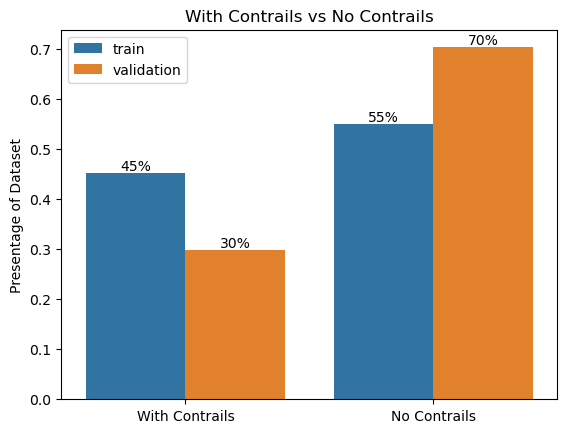

In [9]:
train_with_contrails = train_images_with_contrails / (train_images_with_contrails + train_images_without_contrails)
train_without_contrails = train_images_without_contrails / (train_images_with_contrails + train_images_without_contrails)
validation_with_contrails = validation_images_with_contrails / (validation_images_with_contrails + validation_images_without_contrails)
validation_without_contrails = validation_images_without_contrails / (validation_images_with_contrails + validation_images_without_contrails)
data = pd.DataFrame({'Type': ['With Contrails', 'No Contrails', 'With Contrails', 'No Contrails'],
        'Data': [train_with_contrails, train_without_contrails, validation_with_contrails, validation_without_contrails],
        'Data Set': ['train', 'train', 'validation', 'validation']})

ax = sns.barplot(data=data, y='Data', x="Type", hue="Data Set", orient='v')

for p in ax.patches:
    ax.annotate(format(p.get_height() * 100, '.0f') + '%',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
    
ax.set_xlabel('')
ax.set_ylabel('Presentage of Dataset')
ax.set_title('With Contrails vs No Contrails')

plt.legend()
plt.show()

There is a significantly higher percentage of images with contrails in the train dataset than in the validation.

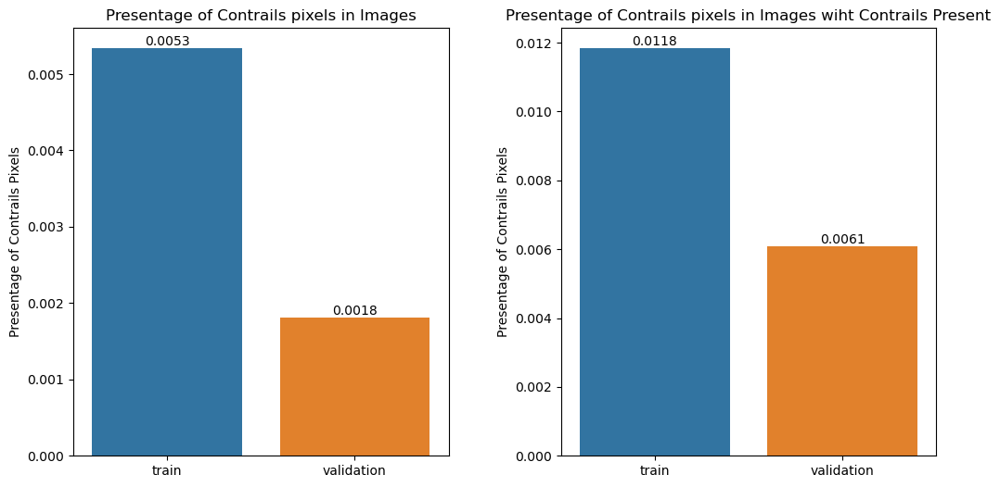

In [10]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
fig.subplots_adjust(wspace=0.3)
axes = axes.flatten()

train_with_contrails_pix = train_contrail_pixel_count / (train_contrail_pixel_count + train_non_contrail_pixel_count)
validation_with_contrails_pix = validation_contrail_pixel_count / (validation_contrail_pixel_count + validation_non_contrail_pixel_count)
data = pd.DataFrame({'Data': [train_with_contrails_pix, validation_with_contrails_pix],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[0])
for p in axes[0].patches:
    axes[0].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[0].set_xlabel('')
axes[0].set_ylabel('Presentage of Contrails Pixels')
axes[0].set_title('Presentage of Contrails pixels in Images')

train_with_contrails_pix_conly = train_contrail_pixel_count_conly / (train_contrail_pixel_count_conly + train_non_contrail_pixel_count_conly)
validation_with_contrails_pix_conly = validation_contrail_pixel_count_conly / (validation_contrail_pixel_count_conly + validation_non_contrail_pixel_count_conly)
data = pd.DataFrame({'Data': [train_with_contrails_pix_conly, validation_with_contrails_pix_conly],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[1])
for p in axes[1].patches:
    axes[1].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[1].set_xlabel('')
axes[1].set_ylabel('Presentage of Contrails Pixels')
axes[1].set_title('Presentage of Contrails pixels in Images wiht Contrails Present')

plt.show()

There is a significant imbalance in the number of pixels between the negative class (non-contrail) and the positive class (contrail). In the training and validation datasets, the ratio of negative to positive class pixels is 85:1 and 164:1 respectively. This severe class imbalance can lead to biased models that prioritize the majority class, ultimately reducing the overall prediction quality.

To address this issue, we can employ two strategies: optimizing the confidence threshold during post-processing or incorporating class weights into the loss function during training.

Optimizing confidence threshold during post-processing:
After training the model, we can adjust the confidence threshold used to determine class predictions. By carefully selecting the threshold, we can increase the sensitivity to the positive class, thereby improving the detection of contrails. This approach allows us to fine-tune the model's predictions without retraining it.

Adding class weights to the loss function during training:
Another way to handle the class imbalance is by assigning appropriate weights to the different classes during model training. By assigning higher weights to the minority class (contrail), we can increase its influence on the loss function. This adjustment ensures that the model pays more attention to the positive class and helps mitigate the bias towards the majority class (non-contrail).

This notebook will utilize both strategies.

Additionally, I thought it was worth pointing out that there are significantly lass contrails in the validation images than in the train images.

In [11]:
def show_band_images(idx: str, parrent_folder: str, band: str):
    data = get_band_images(idx, parrent_folder, band)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_images(idx: str, parrent_folder: str):
    data = get_ash_color_images(idx, parrent_folder)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_frame(idx: str, parrent_folder: str, frame: int):
    data = get_ash_color_images(idx, parrent_folder)
    plt.imshow(data[:,:,:,frame])
    plt.show()
    
def show_mask_image(idx: str, parrent_folder: str):
    plt.imshow(get_mask_image(idx, parrent_folder))
    plt.show()

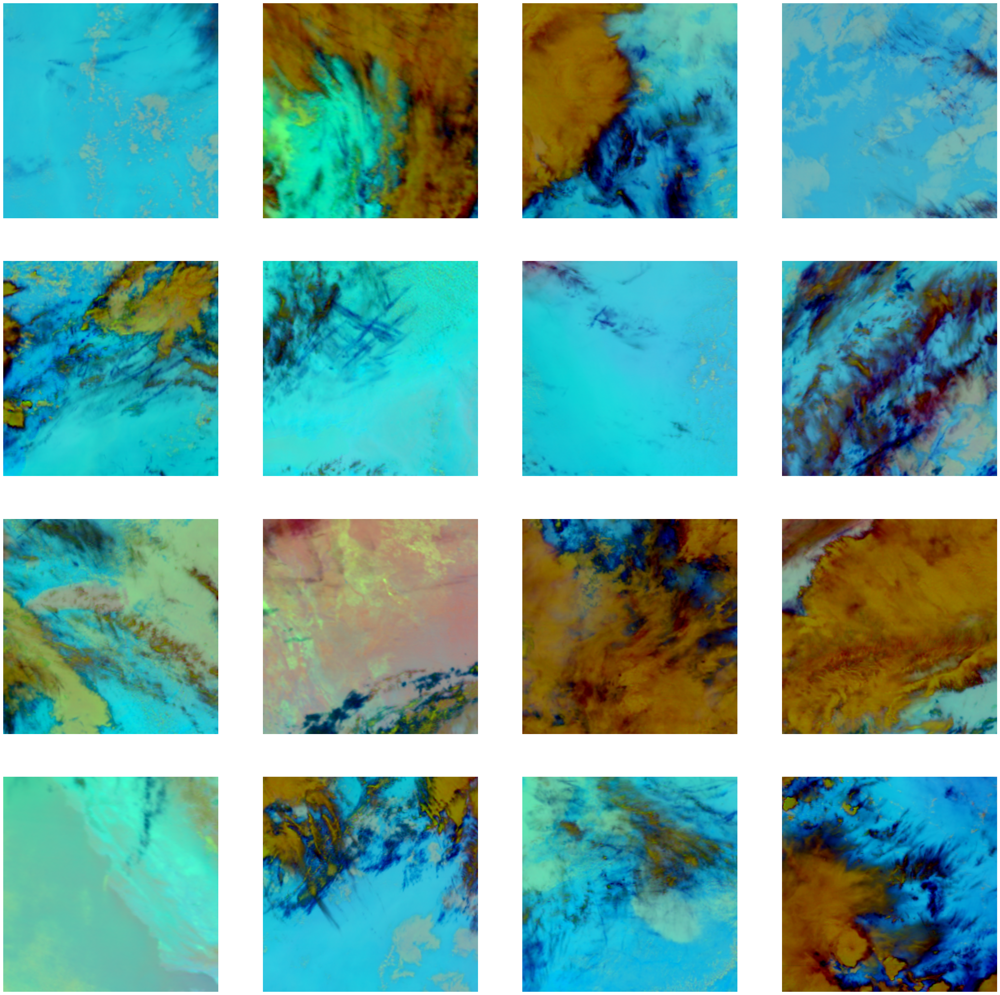

In [12]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(40, 40))
axes = axes.flatten()

for i in range(len(axes)):
    images = get_ash_color_images(str(df_train_idx.iloc[730 + i]['idx']), 'train')
    axes[i].imshow(images[:,:,:,4])
    axes[i].axis('off')

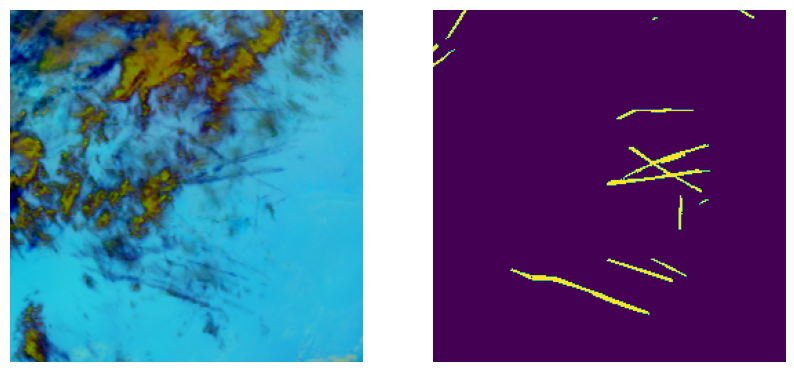

In [13]:
images = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
axes = axes.flatten()

axes[0].imshow(images[:,:,:,4])
axes[0].axis('off')
axes[1].imshow(get_mask_image(str(df_train_idx.iloc[683]['idx']), 'train'))
axes[1].axis('off')

plt.show()

In [14]:
false_color = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
# Animation
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_axis_off()
im = plt.imshow(false_color[..., 0])
def draw(i):
    im.set_array(false_color[..., i])
    return [im]
anim = animation.FuncAnimation(
    fig, draw, frames=false_color.shape[-1], interval=500, blit=True
)
plt.close()
display.HTML(anim.to_jshtml())

# Model

In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [9]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)

        self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = nn.functional.pad(x1, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])
        
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # Define your layers
        self.inc = DoubleConv(24, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        self.down4 = Down(512, 512)
        self.up1 = Up(1024, 256)
        self.up2 = Up(512, 128)
        self.up3 = Up(256, 64)
        self.up4 = Up(128, 64)
        self.outc = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        # Forward pass through the layers
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.outc(x)
        return x

In [10]:
summary(UNet().to(device), input_size=(24, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]          13,888
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,928
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
        DoubleConv-7         [-1, 64, 256, 256]               0
         MaxPool2d-8         [-1, 64, 128, 128]               0
            Conv2d-9        [-1, 128, 128, 128]          73,856
      BatchNorm2d-10        [-1, 128, 128, 128]             256
             ReLU-11        [-1, 128, 128, 128]               0
           Conv2d-12        [-1, 128, 128, 128]         147,584
      BatchNorm2d-13        [-1, 128, 128, 128]             256
             ReLU-14        [-1, 128, 1

# Trainer

In [18]:
class Dice(nn.Module):
    def __init__(self, use_sigmoid=True):
        super(Dice, self).__init__()
        self.sigmoid = nn.Sigmoid()
        self.use_sigmoid = use_sigmoid

    def forward(self, inputs, targets, smooth=1):
        if self.use_sigmoid:
            inputs = self.sigmoid(inputs)       
        
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()
        dice = (2.0 *intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
        return dice
    
dice = Dice()

In [19]:
# Custom combined BCE + Dice Loss function
def combined_bce_dice_loss(pred, target, pos_weight=100):
    """Calculates BCEWithLogitsLoss + Dice Loss."""
    # Binary Cross-Entropy Loss
    bce_loss = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(pos_weight))(pred, target)
    
    # Dice Loss calculation
    pred_probs = torch.sigmoid(pred)  # Apply sigmoid to convert logits to probabilities
    smooth = 1e-6  # To avoid division by zero
    intersection = (pred_probs * target).sum(dim=(1, 2, 3))  # Sum over spatial dimensions
    dice_loss = 1 - (2. * intersection + smooth) / (pred_probs.sum(dim=(1, 2, 3)) + target.sum(dim=(1, 2, 3)) + smooth)
    dice_loss = dice_loss.mean()  # Take mean over batch
    
    # Combine BCE and Dice Loss
    total_loss = bce_loss + dice_loss
    return total_loss

In [20]:
# class MyTrainer:
#     def __init__(self, model, optimizer, loss_fn, lr_scheduler):
#         self.validation_losses = []
#         self.batch_losses = []
#         self.epoch_losses = []
#         self.learning_rates = []
#         self.model = model
#         self.optimizer = optimizer
#         self.loss_fn = loss_fn
#         self.lr_scheduler = lr_scheduler
#         self._check_optim_net_aligned()

#     # Ensures that the given optimizer points to the given model
#     def _check_optim_net_aligned(self):
#         assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

#     # Trains the model
#     def fit(self,
#             train_dataloader: DataLoader,
#             test_dataloader: DataLoader,
#             epochs: int = 10,
#             eval_every: int = 1,
#             ):
  
#         for e in range(epochs):
#             print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
#             self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

#             # Stores data about the batch
#             batch_losses = []
#             sub_batch_losses = []

#             for i, data in enumerate(train_dataloader):
#                 self.model.train()
#                 if i % 100 == 0:
#                     print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
#                     sub_batch_losses.clear()
#                 # Every data instance is an input + label pair
#                 images, mask = data
                
#                 if torch.cuda.is_available():
#                     images = images.cuda()
#                     mask = mask.cuda()

#                 # Zero your gradients for every batch!
#                 self.optimizer.zero_grad()
#                 # Make predictions for this batch
#                 outputs = self.model(images)
#                 # Compute the loss and its gradients
#                 loss = self.loss_fn(outputs, mask)
#                 loss.backward()
#                 # Adjust learning weights
#                 self.optimizer.step()

#                 # Saves data
#                 self.batch_losses.append(loss.item())
#                 batch_losses.append(loss)
#                 sub_batch_losses.append(loss)

#             # Adjusts learning rate
#             if self.lr_scheduler is not None:
#                 self.lr_scheduler.step()

#             # Reports on the path
#             mean_epoch_loss = torch.Tensor(batch_losses).mean()
#             self.epoch_losses.append(mean_epoch_loss.item())
#             print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

#             # Reports on the training progress
#             if (e + 1) % eval_every == 0:
#                 torch.save(self.model.state_dict(), "model_checkpoint_e" + str(e) + ".pt")
#                 with torch.no_grad():
#                     self.model.eval()
#                     losses = []
#                     for i, data in enumerate(test_dataloader):
#                         # Every data instance is an input + label pair
#                         images, mask = data

#                         if torch.cuda.is_available():
#                             images = images.cuda()
#                             mask = mask.cuda()

#                         output = self.model(images)
#                         loss = self.loss_fn(output, mask)
#                         losses.append(loss.item())
                        
#                     avg_loss = torch.Tensor(losses).mean().item()
#                     self.validation_losses.append(avg_loss)
#                     print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

In [21]:
# Trainer with BCE + Dice Loss 
from tqdm import tqdm  # Import tqdm for the progress bar

class MyTrainer:
    def __init__(self, model, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model
        self.optimizer = optimizer
        # self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            ):  
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            # Progress bar for batches
            with tqdm(total=len(train_dataloader), desc=f"Epoch {e+1}/{epochs}", unit="batch") as pbar:
                for i, data in enumerate(train_dataloader):
                    self.model.train()
                    
                    # Update progress bar with the current batch
                    pbar.update(1)
                    pbar.set_postfix(loss=torch.Tensor(sub_batch_losses).mean().item() if sub_batch_losses else 0.0)
                    
                    if i % 100 == 0:
                        print(f'Epoch: {e} Batch: {i}/{len(train_dataloader)} Loss: {torch.Tensor(sub_batch_losses).mean()}')
                        sub_batch_losses.clear()
                    
                    # Every data instance is an input + label pair
                    images, mask = data
                    
                    if torch.cuda.is_available():
                        images = images.cuda()
                        mask = mask.cuda()

                    # Zero your gradients for every batch!
                    self.optimizer.zero_grad()
                    
                    # Make predictions for this batch
                    outputs = self.model(images)
                    
                    # Compute the loss and its gradients
                    # loss = self.loss_fn(outputs, mask)
                    loss = combined_bce_dice_loss(outputs, mask, pos_weight=100)
                    loss.backward()
                    
                    # Adjust learning weights
                    self.optimizer.step()

                    # Saves data
                    self.batch_losses.append(loss.item())
                    batch_losses.append(loss)
                    sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "model_checkpoint_e" + str(e) + ".pt")
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(test_dataloader):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        # loss = self.loss_fn(output, mask)
                        loss = combined_bce_dice_loss(output, mask, pos_weight=100)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))


# Dataset

In [22]:
class ContrailsAshDataset(torch.utils.data.Dataset):
    def __init__(self, parrent_folder: str):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/kaggle/input/google-research-identify-contrails-reduce-global-warming/{parrent_folder}')})
        self.parrent_folder: str = parrent_folder

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: str = str(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(image_id, self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        mask = torch.tensor(get_mask_image(image_id, self.parrent_folder)).to(torch.float32).permute(2, 0, 1)
        return images, mask

In [23]:
dataset_train = ContrailsAshDataset('train')
dataset_validation = ContrailsAshDataset('validation')

data_loader_train = DataLoader(dataset_train, batch_size=16, shuffle=True, num_workers=2)
data_loader_validation = DataLoader(dataset_validation, batch_size=16, shuffle=True, num_workers=2)

# Train

In [24]:
train = True

In [25]:
# BCE + Dice
if train:
    model = UNet()
    model.to(device)

    criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100))
    optimizer = optim.Adam(model.parameters(), lr=0.01)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.70)

    num_epochs = 11

    trainer = MyTrainer(model, optimizer, criterion, lr_scheduler)
    trainer.fit(data_loader_train, data_loader_validation, epochs=num_epochs)
else:
    model = UNet()
    model.load_state_dict(torch.load('/kaggle/input/contrails-unet-pretrained/unet.pt'))
    model.eval()
    model.to(device)

New learning rate: [0.01]


Epoch 1/11:   0%|          | 1/1284 [00:02<48:28,  2.27s/batch, loss=0]

Epoch: 0 Batch: 0/1284 Loss: nan


Epoch 1/11:   8%|▊         | 101/1284 [01:25<14:02,  1.40batch/s, loss=1.83]

Epoch: 0 Batch: 100/1284 Loss: 1.8332220315933228


Epoch 1/11:  16%|█▌        | 201/1284 [02:47<12:57,  1.39batch/s, loss=1.63]

Epoch: 0 Batch: 200/1284 Loss: 1.6316510438919067


Epoch 1/11:  23%|██▎       | 301/1284 [04:07<11:27,  1.43batch/s, loss=1.63]

Epoch: 0 Batch: 300/1284 Loss: 1.6275074481964111


Epoch 1/11:  31%|███       | 401/1284 [05:29<12:44,  1.15batch/s, loss=1.58]

Epoch: 0 Batch: 400/1284 Loss: 1.5788416862487793


Epoch 1/11:  39%|███▉      | 501/1284 [06:54<10:14,  1.27batch/s, loss=1.57]

Epoch: 0 Batch: 500/1284 Loss: 1.5748224258422852


Epoch 1/11:  47%|████▋     | 601/1284 [08:19<08:23,  1.36batch/s, loss=1.53]

Epoch: 0 Batch: 600/1284 Loss: 1.5307862758636475


Epoch 1/11:  55%|█████▍    | 701/1284 [09:47<07:46,  1.25batch/s, loss=1.51]

Epoch: 0 Batch: 700/1284 Loss: 1.5052903890609741


Epoch 1/11:  62%|██████▏   | 801/1284 [11:15<06:25,  1.25batch/s, loss=1.49]

Epoch: 0 Batch: 800/1284 Loss: 1.4895330667495728


Epoch 1/11:  70%|███████   | 901/1284 [12:40<05:02,  1.26batch/s, loss=1.48]

Epoch: 0 Batch: 900/1284 Loss: 1.476007103919983


Epoch 1/11:  78%|███████▊  | 1001/1284 [14:12<04:00,  1.18batch/s, loss=1.45]

Epoch: 0 Batch: 1000/1284 Loss: 1.4535168409347534


Epoch 1/11:  86%|████████▌ | 1101/1284 [15:48<02:38,  1.16batch/s, loss=1.46]

Epoch: 0 Batch: 1100/1284 Loss: 1.4624789953231812


Epoch 1/11:  94%|█████████▎| 1201/1284 [17:19<01:07,  1.24batch/s, loss=1.44]

Epoch: 0 Batch: 1200/1284 Loss: 1.4404492378234863


Epoch 1/11: 100%|██████████| 1284/1284 [18:36<00:00,  1.15batch/s, loss=1.41]

Train Epoch: 0 Average Loss: 1.540928


Validation loss after 1 epochs was 1.2815
New learning rate: [0.006999999999999999]


Epoch 2/11:   0%|          | 1/1284 [00:01<34:54,  1.63s/batch, loss=0]

Epoch: 1 Batch: 0/1284 Loss: nan


Epoch 2/11:   8%|▊         | 101/1284 [01:14<13:59,  1.41batch/s, loss=1.42]

Epoch: 1 Batch: 100/1284 Loss: 1.4172285795211792


Epoch 2/11:  16%|█▌        | 201/1284 [02:27<12:33,  1.44batch/s, loss=1.4] 

Epoch: 1 Batch: 200/1284 Loss: 1.4010376930236816


Epoch 2/11:  23%|██▎       | 301/1284 [03:39<10:38,  1.54batch/s, loss=1.37]

Epoch: 1 Batch: 300/1284 Loss: 1.371585488319397


Epoch 2/11:  31%|███       | 401/1284 [04:53<10:08,  1.45batch/s, loss=1.38]

Epoch: 1 Batch: 400/1284 Loss: 1.382237195968628


Epoch 2/11:  39%|███▉      | 501/1284 [06:10<09:12,  1.42batch/s, loss=1.36]

Epoch: 1 Batch: 500/1284 Loss: 1.3597067594528198


Epoch 2/11:  47%|████▋     | 601/1284 [07:24<07:49,  1.45batch/s, loss=1.36]

Epoch: 1 Batch: 600/1284 Loss: 1.3649075031280518


Epoch 2/11:  55%|█████▍    | 701/1284 [08:41<06:45,  1.44batch/s, loss=1.37]

Epoch: 1 Batch: 700/1284 Loss: 1.3652253150939941


Epoch 2/11:  62%|██████▏   | 801/1284 [09:58<05:47,  1.39batch/s, loss=1.37]

Epoch: 1 Batch: 800/1284 Loss: 1.3711419105529785


Epoch 2/11:  70%|███████   | 901/1284 [11:12<04:16,  1.50batch/s, loss=1.32]

Epoch: 1 Batch: 900/1284 Loss: 1.3231741189956665


Epoch 2/11:  78%|███████▊  | 1001/1284 [12:28<03:09,  1.50batch/s, loss=1.31]

Epoch: 1 Batch: 1000/1284 Loss: 1.3145692348480225


Epoch 2/11:  86%|████████▌ | 1101/1284 [13:46<02:09,  1.42batch/s, loss=1.36]

Epoch: 1 Batch: 1100/1284 Loss: 1.3597830533981323


Epoch 2/11:  94%|█████████▎| 1201/1284 [15:05<00:59,  1.40batch/s, loss=1.31]

Epoch: 1 Batch: 1200/1284 Loss: 1.3123921155929565


Epoch 2/11: 100%|██████████| 1284/1284 [16:10<00:00,  1.32batch/s, loss=1.3] 


Train Epoch: 1 Average Loss: 1.357676
Validation loss after 2 epochs was 1.2014
New learning rate: [0.004899999999999999]


Epoch 3/11:   0%|          | 1/1284 [00:01<30:51,  1.44s/batch, loss=0]

Epoch: 2 Batch: 0/1284 Loss: nan


Epoch 3/11:   8%|▊         | 101/1284 [01:10<12:32,  1.57batch/s, loss=1.28]

Epoch: 2 Batch: 100/1284 Loss: 1.2753585577011108


Epoch 3/11:  16%|█▌        | 201/1284 [02:19<13:25,  1.34batch/s, loss=1.29]

Epoch: 2 Batch: 200/1284 Loss: 1.2899607419967651


Epoch 3/11:  23%|██▎       | 301/1284 [03:29<13:07,  1.25batch/s, loss=1.26]

Epoch: 2 Batch: 300/1284 Loss: 1.2604856491088867


Epoch 3/11:  31%|███       | 401/1284 [04:40<11:49,  1.25batch/s, loss=1.24]

Epoch: 2 Batch: 400/1284 Loss: 1.2354127168655396


Epoch 3/11:  39%|███▉      | 501/1284 [05:52<09:55,  1.31batch/s, loss=1.24]

Epoch: 2 Batch: 500/1284 Loss: 1.2412922382354736


Epoch 3/11:  47%|████▋     | 601/1284 [07:04<08:20,  1.36batch/s, loss=1.25]

Epoch: 2 Batch: 600/1284 Loss: 1.2529211044311523


Epoch 3/11:  55%|█████▍    | 701/1284 [08:19<07:39,  1.27batch/s, loss=1.24]

Epoch: 2 Batch: 700/1284 Loss: 1.2447316646575928


Epoch 3/11:  62%|██████▏   | 801/1284 [09:34<06:41,  1.20batch/s, loss=1.22]

Epoch: 2 Batch: 800/1284 Loss: 1.2244830131530762


Epoch 3/11:  70%|███████   | 901/1284 [10:48<04:30,  1.41batch/s, loss=1.21]

Epoch: 2 Batch: 900/1284 Loss: 1.2130502462387085


Epoch 3/11:  78%|███████▊  | 1001/1284 [12:04<03:15,  1.45batch/s, loss=1.22]

Epoch: 2 Batch: 1000/1284 Loss: 1.219016671180725


Epoch 3/11:  86%|████████▌ | 1101/1284 [13:20<02:07,  1.44batch/s, loss=1.2] 

Epoch: 2 Batch: 1100/1284 Loss: 1.196347713470459


Epoch 3/11:  94%|█████████▎| 1201/1284 [14:37<01:03,  1.30batch/s, loss=1.2] 

Epoch: 2 Batch: 1200/1284 Loss: 1.1964139938354492


Epoch 3/11: 100%|██████████| 1284/1284 [15:41<00:00,  1.36batch/s, loss=1.2] 


Train Epoch: 2 Average Loss: 1.234696
Validation loss after 3 epochs was 1.1473
New learning rate: [0.003429999999999999]


Epoch 4/11:   0%|          | 1/1284 [00:01<32:12,  1.51s/batch, loss=0]

Epoch: 3 Batch: 0/1284 Loss: nan


Epoch 4/11:   8%|▊         | 101/1284 [01:14<13:18,  1.48batch/s, loss=1.17]

Epoch: 3 Batch: 100/1284 Loss: 1.1671868562698364


Epoch 4/11:  16%|█▌        | 201/1284 [02:29<12:18,  1.47batch/s, loss=1.16]

Epoch: 3 Batch: 200/1284 Loss: 1.1597517728805542


Epoch 4/11:  23%|██▎       | 301/1284 [03:45<12:11,  1.34batch/s, loss=1.16]

Epoch: 3 Batch: 300/1284 Loss: 1.1584296226501465


Epoch 4/11:  31%|███       | 401/1284 [05:03<10:41,  1.38batch/s, loss=1.15]

Epoch: 3 Batch: 400/1284 Loss: 1.1477651596069336


Epoch 4/11:  39%|███▉      | 501/1284 [06:23<10:03,  1.30batch/s, loss=1.15]

Epoch: 3 Batch: 500/1284 Loss: 1.1461987495422363


Epoch 4/11:  47%|████▋     | 601/1284 [07:43<08:24,  1.35batch/s, loss=1.15]

Epoch: 3 Batch: 600/1284 Loss: 1.1513770818710327


Epoch 4/11:  55%|█████▍    | 701/1284 [09:04<06:46,  1.43batch/s, loss=1.15]

Epoch: 3 Batch: 700/1284 Loss: 1.1457695960998535


Epoch 4/11:  62%|██████▏   | 801/1284 [10:23<05:53,  1.37batch/s, loss=1.16]

Epoch: 3 Batch: 800/1284 Loss: 1.1583868265151978


Epoch 4/11:  70%|███████   | 901/1284 [11:44<04:47,  1.33batch/s, loss=1.16]

Epoch: 3 Batch: 900/1284 Loss: 1.1636968851089478


Epoch 4/11:  78%|███████▊  | 1001/1284 [13:03<03:23,  1.39batch/s, loss=1.14]

Epoch: 3 Batch: 1000/1284 Loss: 1.141007900238037


Epoch 4/11:  86%|████████▌ | 1101/1284 [14:25<02:15,  1.35batch/s, loss=1.16]

Epoch: 3 Batch: 1100/1284 Loss: 1.1567680835723877


Epoch 4/11:  94%|█████████▎| 1201/1284 [15:48<01:03,  1.31batch/s, loss=1.14]

Epoch: 3 Batch: 1200/1284 Loss: 1.1441370248794556


Epoch 4/11: 100%|██████████| 1284/1284 [16:56<00:00,  1.26batch/s, loss=1.12]


Train Epoch: 3 Average Loss: 1.151180
Validation loss after 4 epochs was 1.087
New learning rate: [0.002400999999999999]


Epoch 5/11:   0%|          | 1/1284 [00:01<32:07,  1.50s/batch, loss=0]

Epoch: 4 Batch: 0/1284 Loss: nan


Epoch 5/11:   8%|▊         | 101/1284 [01:11<14:30,  1.36batch/s, loss=1.1]

Epoch: 4 Batch: 100/1284 Loss: 1.1039658784866333


Epoch 5/11:  16%|█▌        | 201/1284 [02:21<13:25,  1.34batch/s, loss=1.11]

Epoch: 4 Batch: 200/1284 Loss: 1.1144391298294067


Epoch 5/11:  23%|██▎       | 301/1284 [03:34<11:22,  1.44batch/s, loss=1.11]

Epoch: 4 Batch: 300/1284 Loss: 1.1089026927947998


Epoch 5/11:  31%|███       | 401/1284 [04:51<09:55,  1.48batch/s, loss=1.1] 

Epoch: 4 Batch: 400/1284 Loss: 1.1049718856811523


Epoch 5/11:  39%|███▉      | 501/1284 [06:09<09:53,  1.32batch/s, loss=1.11]

Epoch: 4 Batch: 500/1284 Loss: 1.1069834232330322


Epoch 5/11:  47%|████▋     | 601/1284 [07:28<07:56,  1.43batch/s, loss=1.09]

Epoch: 4 Batch: 600/1284 Loss: 1.0948032140731812


Epoch 5/11:  55%|█████▍    | 701/1284 [08:50<07:26,  1.30batch/s, loss=1.11]

Epoch: 4 Batch: 700/1284 Loss: 1.1080963611602783


Epoch 5/11:  62%|██████▏   | 801/1284 [10:08<05:45,  1.40batch/s, loss=1.1] 

Epoch: 4 Batch: 800/1284 Loss: 1.1019229888916016


Epoch 5/11:  70%|███████   | 901/1284 [11:27<04:42,  1.35batch/s, loss=1.1] 

Epoch: 4 Batch: 900/1284 Loss: 1.1025522947311401


Epoch 5/11:  78%|███████▊  | 1001/1284 [12:47<03:21,  1.40batch/s, loss=1.11]

Epoch: 4 Batch: 1000/1284 Loss: 1.1114552021026611


Epoch 5/11:  86%|████████▌ | 1101/1284 [14:06<02:10,  1.40batch/s, loss=1.11]

Epoch: 4 Batch: 1100/1284 Loss: 1.10553777217865


Epoch 5/11:  94%|█████████▎| 1201/1284 [15:25<01:00,  1.38batch/s, loss=1.1] 

Epoch: 4 Batch: 1200/1284 Loss: 1.0950227975845337


Epoch 5/11: 100%|██████████| 1284/1284 [16:31<00:00,  1.29batch/s, loss=1.1] 


Train Epoch: 4 Average Loss: 1.106988
Validation loss after 5 epochs was 1.0695
New learning rate: [0.0016806999999999992]


Epoch 6/11:   0%|          | 1/1284 [00:01<29:15,  1.37s/batch, loss=0]

Epoch: 5 Batch: 0/1284 Loss: nan


Epoch 6/11:   8%|▊         | 101/1284 [01:11<12:08,  1.62batch/s, loss=1.1]

Epoch: 5 Batch: 100/1284 Loss: 1.095900297164917


Epoch 6/11:  16%|█▌        | 201/1284 [02:21<14:44,  1.22batch/s, loss=1.08]

Epoch: 5 Batch: 200/1284 Loss: 1.0817548036575317


Epoch 6/11:  23%|██▎       | 301/1284 [03:32<12:24,  1.32batch/s, loss=1.07]

Epoch: 5 Batch: 300/1284 Loss: 1.0730597972869873


Epoch 6/11:  31%|███       | 401/1284 [04:44<11:09,  1.32batch/s, loss=1.07] 

Epoch: 5 Batch: 400/1284 Loss: 1.068087100982666


Epoch 6/11:  39%|███▉      | 501/1284 [05:57<10:17,  1.27batch/s, loss=1.07]

Epoch: 5 Batch: 500/1284 Loss: 1.0672575235366821


Epoch 6/11:  47%|████▋     | 601/1284 [07:13<08:49,  1.29batch/s, loss=1.08]

Epoch: 5 Batch: 600/1284 Loss: 1.0817195177078247


Epoch 6/11:  55%|█████▍    | 701/1284 [08:28<07:33,  1.29batch/s, loss=1.08]

Epoch: 5 Batch: 700/1284 Loss: 1.080418348312378


Epoch 6/11:  62%|██████▏   | 801/1284 [09:44<06:45,  1.19batch/s, loss=1.05]

Epoch: 5 Batch: 800/1284 Loss: 1.0533608198165894


Epoch 6/11:  70%|███████   | 901/1284 [10:59<05:04,  1.26batch/s, loss=1.07]

Epoch: 5 Batch: 900/1284 Loss: 1.0734070539474487


Epoch 6/11:  78%|███████▊  | 1001/1284 [12:15<03:53,  1.21batch/s, loss=1.06]

Epoch: 5 Batch: 1000/1284 Loss: 1.0606762170791626


Epoch 6/11:  86%|████████▌ | 1101/1284 [13:29<02:30,  1.22batch/s, loss=1.06]

Epoch: 5 Batch: 1100/1284 Loss: 1.0606582164764404


Epoch 6/11:  94%|█████████▎| 1201/1284 [14:45<01:09,  1.20batch/s, loss=1.07] 

Epoch: 5 Batch: 1200/1284 Loss: 1.06878662109375


Epoch 6/11: 100%|██████████| 1284/1284 [15:47<00:00,  1.36batch/s, loss=1.07]


Train Epoch: 5 Average Loss: 1.071621
Validation loss after 6 epochs was 1.0534
New learning rate: [0.0011764899999999994]


Epoch 7/11:   0%|          | 1/1284 [00:01<32:43,  1.53s/batch, loss=0]

Epoch: 6 Batch: 0/1284 Loss: nan


Epoch 7/11:   8%|▊         | 101/1284 [01:08<13:57,  1.41batch/s, loss=1.04]

Epoch: 6 Batch: 100/1284 Loss: 1.044877290725708


Epoch 7/11:  16%|█▌        | 201/1284 [02:16<12:18,  1.47batch/s, loss=1.05]

Epoch: 6 Batch: 200/1284 Loss: 1.0514614582061768


Epoch 7/11:  23%|██▎       | 301/1284 [03:26<12:22,  1.32batch/s, loss=1.04]

Epoch: 6 Batch: 300/1284 Loss: 1.0441608428955078


Epoch 7/11:  31%|███       | 401/1284 [04:38<12:15,  1.20batch/s, loss=1.03]

Epoch: 6 Batch: 400/1284 Loss: 1.030583381652832


Epoch 7/11:  39%|███▉      | 501/1284 [05:50<10:30,  1.24batch/s, loss=1.04]

Epoch: 6 Batch: 500/1284 Loss: 1.0368597507476807


Epoch 7/11:  47%|████▋     | 601/1284 [07:05<09:25,  1.21batch/s, loss=1.05]

Epoch: 6 Batch: 600/1284 Loss: 1.0460013151168823


Epoch 7/11:  55%|█████▍    | 701/1284 [08:18<07:52,  1.23batch/s, loss=1.06] 

Epoch: 6 Batch: 700/1284 Loss: 1.059352159500122


Epoch 7/11:  62%|██████▏   | 801/1284 [09:31<06:20,  1.27batch/s, loss=1.04]

Epoch: 6 Batch: 800/1284 Loss: 1.042748212814331


Epoch 7/11:  70%|███████   | 901/1284 [10:45<05:05,  1.25batch/s, loss=1.05]

Epoch: 6 Batch: 900/1284 Loss: 1.0531044006347656


Epoch 7/11:  78%|███████▊  | 1001/1284 [12:00<03:52,  1.22batch/s, loss=1.03]

Epoch: 6 Batch: 1000/1284 Loss: 1.0315051078796387


Epoch 7/11:  86%|████████▌ | 1101/1284 [13:16<02:28,  1.23batch/s, loss=1.05]

Epoch: 6 Batch: 1100/1284 Loss: 1.052079677581787


Epoch 7/11:  94%|█████████▎| 1201/1284 [14:33<01:08,  1.21batch/s, loss=1.04] 

Epoch: 6 Batch: 1200/1284 Loss: 1.0388946533203125


Epoch 7/11: 100%|██████████| 1284/1284 [15:35<00:00,  1.37batch/s, loss=1.03]


Train Epoch: 6 Average Loss: 1.043072
Validation loss after 7 epochs was 1.0465
New learning rate: [0.0008235429999999996]


Epoch 8/11:   0%|          | 1/1284 [00:01<33:54,  1.59s/batch, loss=0]

Epoch: 7 Batch: 0/1284 Loss: nan


Epoch 8/11:   8%|▊         | 101/1284 [01:11<12:56,  1.52batch/s, loss=1.03]

Epoch: 7 Batch: 100/1284 Loss: 1.031785249710083


Epoch 8/11:  16%|█▌        | 201/1284 [02:24<11:58,  1.51batch/s, loss=1.03]

Epoch: 7 Batch: 200/1284 Loss: 1.0271209478378296


Epoch 8/11:  23%|██▎       | 301/1284 [03:38<10:54,  1.50batch/s, loss=1.03] 

Epoch: 7 Batch: 300/1284 Loss: 1.0301624536514282


Epoch 8/11:  31%|███       | 401/1284 [04:52<10:11,  1.44batch/s, loss=1.03]

Epoch: 7 Batch: 400/1284 Loss: 1.0317623615264893


Epoch 8/11:  39%|███▉      | 501/1284 [06:09<09:17,  1.40batch/s, loss=1.02] 

Epoch: 7 Batch: 500/1284 Loss: 1.023288369178772


Epoch 8/11:  47%|████▋     | 601/1284 [07:27<08:27,  1.35batch/s, loss=1.02] 

Epoch: 7 Batch: 600/1284 Loss: 1.0200001001358032


Epoch 8/11:  55%|█████▍    | 701/1284 [08:46<08:15,  1.18batch/s, loss=1.02]

Epoch: 7 Batch: 700/1284 Loss: 1.0242056846618652


Epoch 8/11:  62%|██████▏   | 801/1284 [10:09<05:34,  1.44batch/s, loss=1.01] 

Epoch: 7 Batch: 800/1284 Loss: 1.0149089097976685


Epoch 8/11:  70%|███████   | 901/1284 [11:29<04:29,  1.42batch/s, loss=1.02] 

Epoch: 7 Batch: 900/1284 Loss: 1.0227628946304321


Epoch 8/11:  78%|███████▊  | 1001/1284 [12:50<03:32,  1.33batch/s, loss=1.02]

Epoch: 7 Batch: 1000/1284 Loss: 1.0172730684280396


Epoch 8/11:  86%|████████▌ | 1101/1284 [14:10<02:05,  1.46batch/s, loss=1.02] 

Epoch: 7 Batch: 1100/1284 Loss: 1.017152190208435


Epoch 8/11:  94%|█████████▎| 1201/1284 [15:30<00:59,  1.39batch/s, loss=1.02] 

Epoch: 7 Batch: 1200/1284 Loss: 1.0153197050094604


Epoch 8/11: 100%|██████████| 1284/1284 [16:35<00:00,  1.29batch/s, loss=1.02] 


Train Epoch: 7 Average Loss: 1.022521
Validation loss after 8 epochs was 1.0405
New learning rate: [0.0005764800999999997]


Epoch 9/11:   0%|          | 1/1284 [00:01<29:34,  1.38s/batch, loss=0]

Epoch: 8 Batch: 0/1284 Loss: nan


Epoch 9/11:   8%|▊         | 101/1284 [01:13<15:14,  1.29batch/s, loss=1.01]

Epoch: 8 Batch: 100/1284 Loss: 1.0105392932891846


Epoch 9/11:  16%|█▌        | 201/1284 [02:25<13:40,  1.32batch/s, loss=1.01] 

Epoch: 8 Batch: 200/1284 Loss: 1.0146595239639282


Epoch 9/11:  23%|██▎       | 301/1284 [03:38<12:41,  1.29batch/s, loss=1.01] 

Epoch: 8 Batch: 300/1284 Loss: 1.0062453746795654


Epoch 9/11:  31%|███       | 401/1284 [04:51<11:40,  1.26batch/s, loss=1.01]

Epoch: 8 Batch: 400/1284 Loss: 1.014012336730957


Epoch 9/11:  39%|███▉      | 501/1284 [06:08<11:06,  1.18batch/s, loss=1]    

Epoch: 8 Batch: 500/1284 Loss: 1.001779556274414


Epoch 9/11:  47%|████▋     | 601/1284 [07:23<09:13,  1.23batch/s, loss=1]    

Epoch: 8 Batch: 600/1284 Loss: 1.0029664039611816


Epoch 9/11:  55%|█████▍    | 701/1284 [08:39<07:52,  1.23batch/s, loss=1]   

Epoch: 8 Batch: 700/1284 Loss: 1.0008635520935059


Epoch 9/11:  62%|██████▏   | 801/1284 [09:55<06:33,  1.23batch/s, loss=1.01] 

Epoch: 8 Batch: 800/1284 Loss: 1.0097323656082153


Epoch 9/11:  70%|███████   | 901/1284 [11:12<05:26,  1.17batch/s, loss=0.989]

Epoch: 8 Batch: 900/1284 Loss: 0.988537073135376


Epoch 9/11:  78%|███████▊  | 1001/1284 [12:29<03:59,  1.18batch/s, loss=1.01]

Epoch: 8 Batch: 1000/1284 Loss: 1.010845422744751


Epoch 9/11:  86%|████████▌ | 1101/1284 [13:47<02:37,  1.16batch/s, loss=0.996]

Epoch: 8 Batch: 1100/1284 Loss: 0.9962853789329529


Epoch 9/11:  94%|█████████▎| 1201/1284 [15:05<01:08,  1.21batch/s, loss=1]    

Epoch: 8 Batch: 1200/1284 Loss: 1.0000609159469604


Epoch 9/11: 100%|██████████| 1284/1284 [16:08<00:00,  1.33batch/s, loss=1.01] 


Train Epoch: 8 Average Loss: 1.005015
Validation loss after 9 epochs was 1.0408
New learning rate: [0.00040353606999999974]


Epoch 10/11:   0%|          | 1/1284 [00:01<32:31,  1.52s/batch, loss=0]

Epoch: 9 Batch: 0/1284 Loss: nan


Epoch 10/11:   8%|▊         | 101/1284 [01:09<14:54,  1.32batch/s, loss=1]   

Epoch: 9 Batch: 100/1284 Loss: 0.9997445940971375


Epoch 10/11:  16%|█▌        | 201/1284 [02:18<13:02,  1.38batch/s, loss=0.992]

Epoch: 9 Batch: 200/1284 Loss: 0.9920153021812439


Epoch 10/11:  23%|██▎       | 301/1284 [03:28<13:09,  1.25batch/s, loss=0.979]

Epoch: 9 Batch: 300/1284 Loss: 0.9788699150085449


Epoch 10/11:  31%|███       | 401/1284 [04:39<11:16,  1.31batch/s, loss=0.982]

Epoch: 9 Batch: 400/1284 Loss: 0.9816879034042358


Epoch 10/11:  39%|███▉      | 501/1284 [05:53<10:38,  1.23batch/s, loss=0.984]

Epoch: 9 Batch: 500/1284 Loss: 0.9835182428359985


Epoch 10/11:  47%|████▋     | 601/1284 [07:06<08:49,  1.29batch/s, loss=1]    

Epoch: 9 Batch: 600/1284 Loss: 0.9999238848686218


Epoch 10/11:  55%|█████▍    | 701/1284 [08:20<08:08,  1.19batch/s, loss=0.995]

Epoch: 9 Batch: 700/1284 Loss: 0.9949296712875366


Epoch 10/11:  62%|██████▏   | 801/1284 [09:35<06:28,  1.24batch/s, loss=0.994]

Epoch: 9 Batch: 800/1284 Loss: 0.9935325384140015


Epoch 10/11:  70%|███████   | 901/1284 [10:50<05:00,  1.27batch/s, loss=0.986]

Epoch: 9 Batch: 900/1284 Loss: 0.9863432049751282


Epoch 10/11:  78%|███████▊  | 1001/1284 [12:04<03:57,  1.19batch/s, loss=0.994]

Epoch: 9 Batch: 1000/1284 Loss: 0.9935747385025024


Epoch 10/11:  86%|████████▌ | 1101/1284 [13:21<02:40,  1.14batch/s, loss=0.991]

Epoch: 9 Batch: 1100/1284 Loss: 0.9908608794212341


Epoch 10/11:  94%|█████████▎| 1201/1284 [14:37<01:09,  1.19batch/s, loss=0.992]

Epoch: 9 Batch: 1200/1284 Loss: 0.9923643469810486


Epoch 10/11: 100%|██████████| 1284/1284 [15:37<00:00,  1.37batch/s, loss=0.989]


Train Epoch: 9 Average Loss: 0.990546
Validation loss after 10 epochs was 1.0409
New learning rate: [0.0002824752489999998]


Epoch 11/11:   0%|          | 1/1284 [00:01<32:58,  1.54s/batch, loss=0]

Epoch: 10 Batch: 0/1284 Loss: nan


Epoch 11/11:   8%|▊         | 101/1284 [01:09<14:12,  1.39batch/s, loss=0.981]

Epoch: 10 Batch: 100/1284 Loss: 0.9814780950546265


Epoch 11/11:  16%|█▌        | 201/1284 [02:17<14:11,  1.27batch/s, loss=0.988]

Epoch: 10 Batch: 200/1284 Loss: 0.9876613020896912


Epoch 11/11:  23%|██▎       | 301/1284 [03:25<11:18,  1.45batch/s, loss=0.982]

Epoch: 10 Batch: 300/1284 Loss: 0.9817804098129272


Epoch 11/11:  31%|███       | 401/1284 [04:36<09:50,  1.49batch/s, loss=0.972]

Epoch: 10 Batch: 400/1284 Loss: 0.9716725945472717


Epoch 11/11:  39%|███▉      | 501/1284 [05:49<08:21,  1.56batch/s, loss=0.984]

Epoch: 10 Batch: 500/1284 Loss: 0.9836775064468384


Epoch 11/11:  47%|████▋     | 601/1284 [06:59<07:15,  1.57batch/s, loss=0.981]

Epoch: 10 Batch: 600/1284 Loss: 0.9814594984054565


Epoch 11/11:  55%|█████▍    | 701/1284 [08:13<06:16,  1.55batch/s, loss=0.98] 

Epoch: 10 Batch: 700/1284 Loss: 0.9797002673149109


Epoch 11/11:  62%|██████▏   | 801/1284 [09:25<05:10,  1.56batch/s, loss=0.986]

Epoch: 10 Batch: 800/1284 Loss: 0.9863447546958923


Epoch 11/11:  70%|███████   | 901/1284 [10:39<04:12,  1.52batch/s, loss=0.971]

Epoch: 10 Batch: 900/1284 Loss: 0.9707249402999878


Epoch 11/11:  78%|███████▊  | 1001/1284 [11:53<03:05,  1.52batch/s, loss=0.978]

Epoch: 10 Batch: 1000/1284 Loss: 0.9781072735786438


Epoch 11/11:  86%|████████▌ | 1101/1284 [13:07<02:01,  1.51batch/s, loss=0.984]

Epoch: 10 Batch: 1100/1284 Loss: 0.9843949675559998


Epoch 11/11:  94%|█████████▎| 1201/1284 [14:20<00:55,  1.48batch/s, loss=0.99] 

Epoch: 10 Batch: 1200/1284 Loss: 0.9896210432052612


Epoch 11/11: 100%|██████████| 1284/1284 [15:20<00:00,  1.39batch/s, loss=0.969]


Train Epoch: 10 Average Loss: 0.981033
Validation loss after 11 epochs was 1.0302


# Training Overview

In [1]:
if train:
    df_data = pd.DataFrame({'Batch Losses': trainer.batch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Batch')
    plt.ylabel('Loss')
    plt.title('Batch Loss')
    plt.show()

NameError: name 'train' is not defined

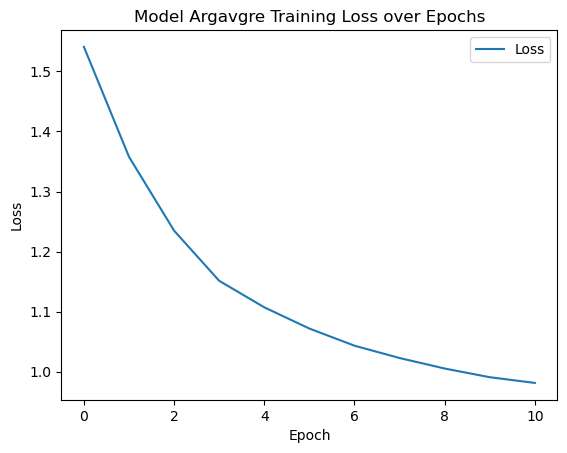

In [27]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.epoch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Argavgre Training Loss over Epochs')
    plt.show()

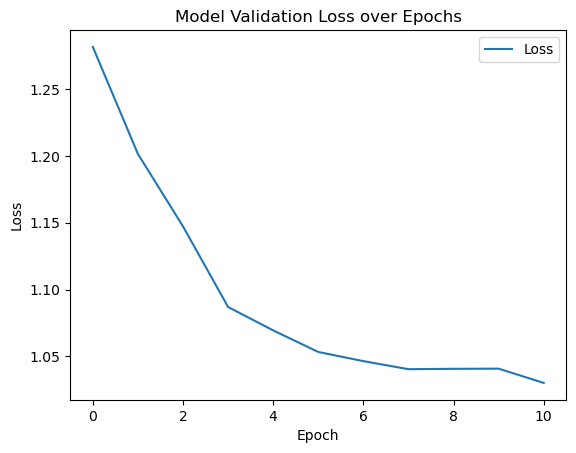

In [28]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.validation_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Validation Loss over Epochs')
    plt.show()

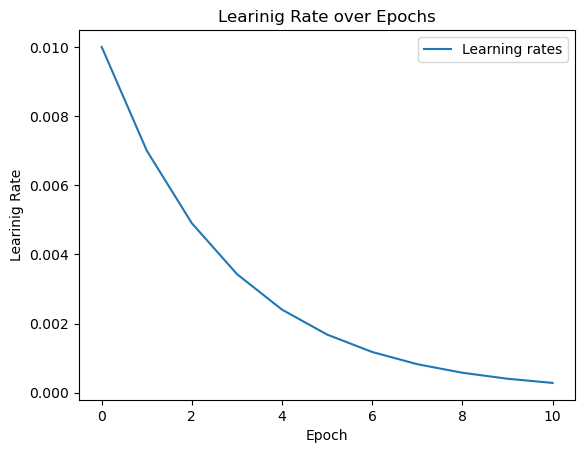

In [29]:
if train:
    df_data = pd.DataFrame({'Learning rates': trainer.learning_rates})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Learinig Rate')
    plt.title('Learinig Rate over Epochs')
    plt.show()

# Find Optimal Threshold

In [30]:
class DiceThresholdTester:
    
    def __init__(self, model: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

In [31]:
dice_threshold_tester = DiceThresholdTester(model, data_loader_validation)
dice_threshold_tester.precalculate_prediction()

In [32]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.97 with dice: 0.5331060831958606


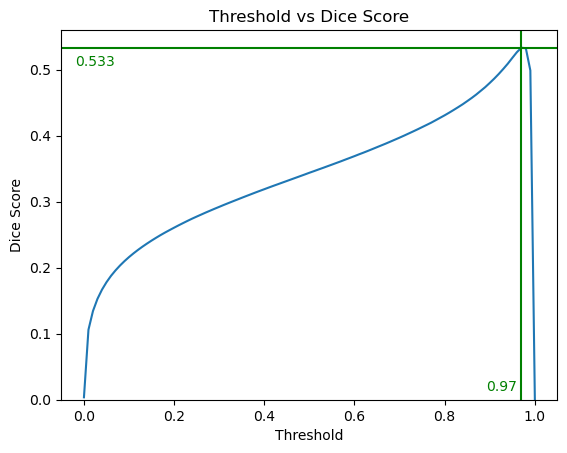

In [33]:
sns.lineplot(data=df_threshold_data, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

# Preview Models Predictions on Validation

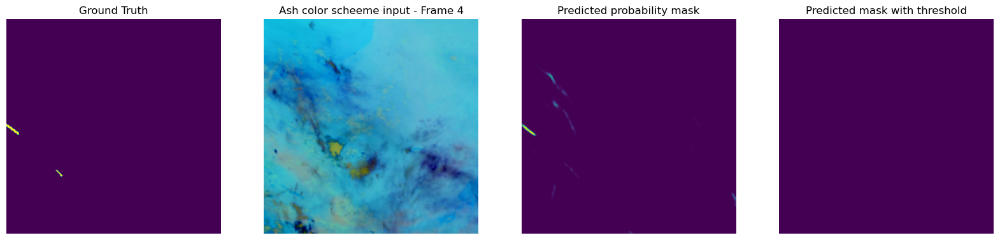

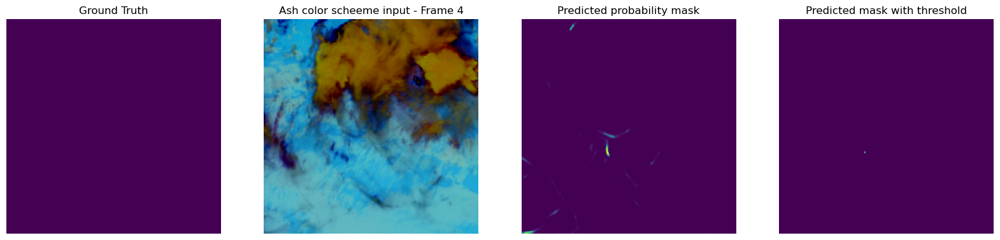

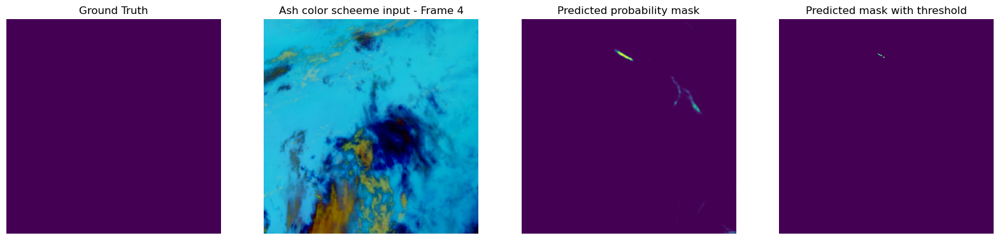

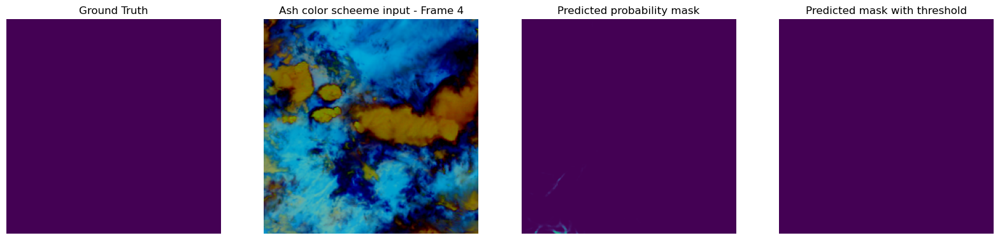

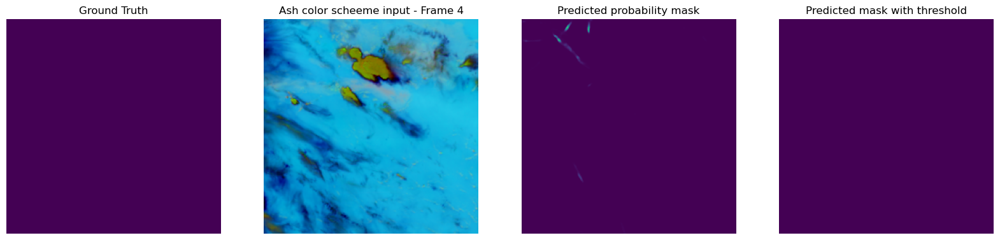

...

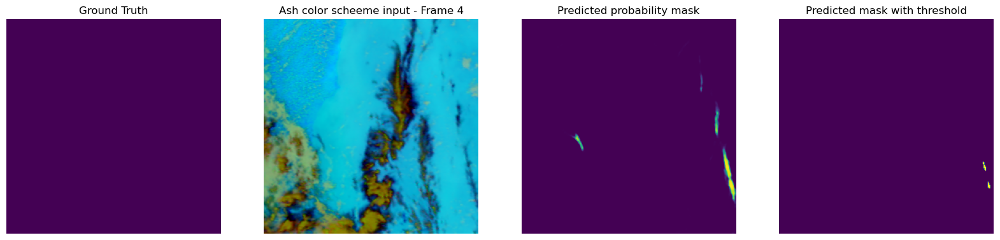

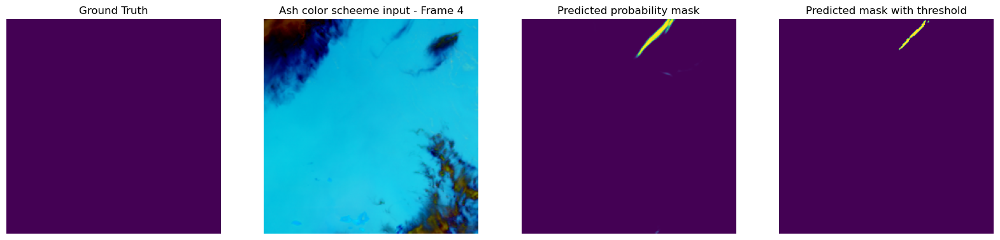

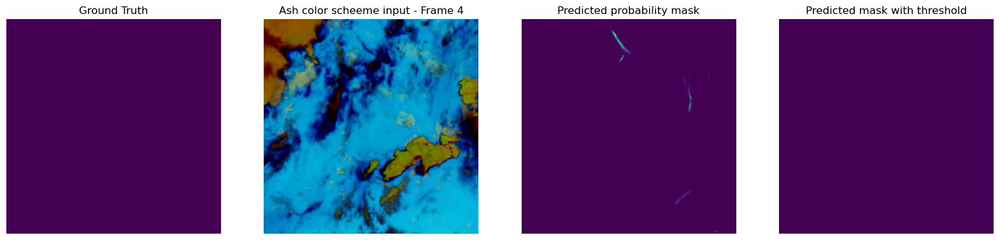

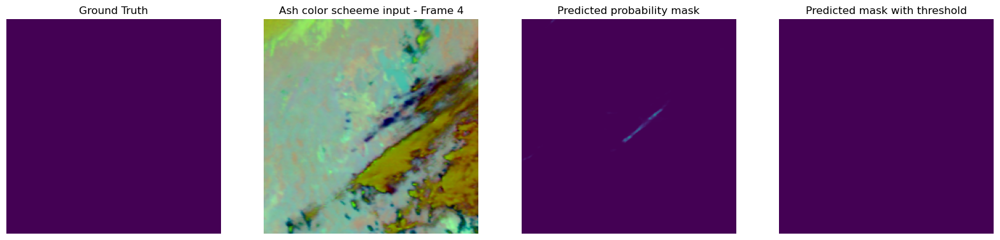

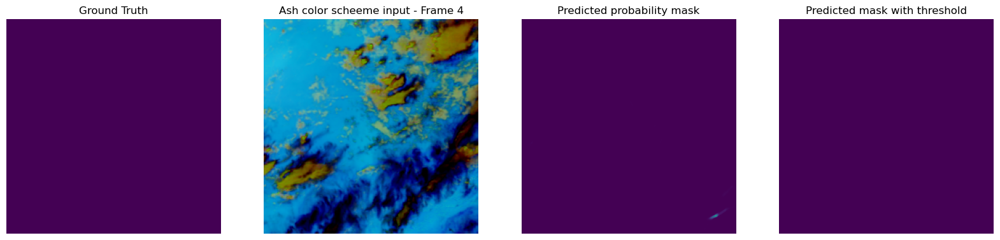

In [34]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

batches_to_show = 4
model.eval()

for i, data in enumerate(data_loader_validation):
    images, mask = data
    
    # Predict mask for this instance
    if torch.cuda.is_available():
        images = images.cuda()
    predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
    # Apply threshold
    predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
    images = images.cpu()
        
    for img_num in range(0, images.shape[0]):
        fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,10))
        axes = axes.flatten()
        
        # Show groud trought 
        axes[0].imshow(mask[img_num, 0, :, :])
        axes[0].axis('off')
        axes[0].set_title('Ground Truth')
        
        # Show ash color scheme input image
        axes[1].imshow( np.concatenate(
            (
            np.expand_dims(images[img_num, 4, :, :], axis=2),
            np.expand_dims(images[img_num, 12, :, :], axis=2),
            np.expand_dims(images[img_num, 20, :, :], axis=2)
        ), axis=2))
        axes[1].axis('off')
        axes[1].set_title('Ash color scheeme input - Frame 4')

        # Show predicted mask
        axes[2].imshow(predicated_mask[img_num, 0, :, :], vmin=0, vmax=1)
        axes[2].axis('off')
        axes[2].set_title('Predicted probability mask')

        # Show predicted mask after threshold
        axes[3].imshow(predicated_mask_with_threshold[img_num, :, :])
        axes[3].axis('off')
        axes[3].set_title('Predicted mask with threshold')
        plt.show()
    
    if i + 1 >= batches_to_show:
        break

In [42]:
torch.save(model.state_dict(), 'model_weights.pth')

# Submission

In [35]:
# Same a the ContrailsAshDataset but does not load the mask (since its not avalble for test) and returns image_id instaed of the mask to assamble submission
class ContrailsAshTestDataset(torch.utils.data.Dataset):
    def __init__(self):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/kaggle/input/google-research-identify-contrails-reduce-global-warming/test')})
        self.parrent_folder: str = 'test'

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: int = int(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(str(image_id), self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        return images,  torch.tensor(image_id)

In [36]:
dataset_test = ContrailsAshTestDataset()
data_loader_test = DataLoader(dataset_test, batch_size=16, shuffle=True, num_workers=2)

In [37]:
#source https://www.kaggle.com/code/inversion/contrails-rle-submission?scriptVersionId=128527711&cellId=4

def rle_encode(x, fg_val=1):
    """
    Args:
        x:  numpy array of shape (height, width), 1 - mask, 0 - background
    Returns: run length encoding as list
    """

    dots = np.where(
        x.T.flatten() == fg_val)[0]  # .T sets Fortran order down-then-right
    run_lengths = []
    prev = -2
    for b in dots:
        if b > prev + 1:
            run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths


def list_to_string(x):
    """
    Converts list to a string representation
    Empty list returns '-'
    """
    if x: # non-empty list
        s = str(x).replace("[", "").replace("]", "").replace(",", "")
    else:
        s = '-'
    return s

In [38]:
submission = pd.read_csv('/kaggle/input/google-research-identify-contrails-reduce-global-warming/sample_submission.csv', index_col='record_id')

In [39]:
for i, data in enumerate(data_loader_test):
    images, image_id = data
    
    # Predict mask for this instance
    if torch.cuda.is_available():
        images = images.cuda()
    predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
    # Apply threshold
    predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
    for img_num in range(0, images.shape[0]):
        current_mask = predicated_mask_with_threshold[img_num, :, :]
        current_image_id = image_id[img_num].item()
        
        submission.loc[int(current_image_id), 'encoded_pixels'] = list_to_string(rle_encode(current_mask))

In [40]:
submission

,encoded_pixels
record_id,
1000834164244036115,40966 1 41221 4 41479 4 41736 5 41994 5 42251 ...
1002653297254493116,37012 8 37269 11 37529 9 37789 8 38048 10 3830...


In [41]:
submission.to_csv('submission.csv')